과제 내용 : 기계 독해 (LSTM 기반 영영화 긍/부정 결과 데이터셋 결과 기반 예측.)


#Mission! : 

vocab tockenizer, batch 크기 등과 

LSTM 모델의 하이퍼파라미터를 튜닝해서 최대한 

Accuracy를 올려보세요!

In [ ]:
import pandas as pd
import torch
from torch.utils.data import Dataset, DataLoader
from torch.autograd import Variable
import torch.nn.functional as F

In [ ]:
import torch
import torch.nn as nn
import urllib.request
DEVICE = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

데이터 깃헙에서 받아주겠습니다. 대표적인 영어데이터인 IMDB 리뷰데이터입니다.

In [ ]:
urllib.request.urlretrieve("https://raw.githubusercontent.com/LawrenceDuan/IMDb-Review-Analysis/master/IMDb_Reviews.csv", filename="IMDb_Reviews.csv")

('IMDb_Reviews.csv', <http.client.HTTPMessage at 0x7faf5afce0d0>)

In [ ]:
df = pd.read_csv('IMDb_Reviews.csv', encoding='utf-8')
df.head()

,review,sentiment
0,My family and I normally do not watch local mo...,1
1,"Believe it or not, this was at one time the wo...",0
2,"After some internet surfing, I found the ""Home...",0
3,One of the most unheralded great works of anim...,1
4,"It was the Sixties, and anyone with long hair ...",0


첫 열은 영화 리뷰로, 둘째 열은 긍정/부정을 나타내는 열입니다. (긍정 1 부정 0)

In [ ]:
print('전체 샘플의 개수 : {}'.format(len(df)))

전체 샘플의 개수 : 50000


샘플 개수 50000개, 4 대 1 로 나눠주겠습니다.

In [ ]:
train_datapipe = df[:40000]
test_datapipe = df[40000:]

여러분의 커스텀 데이터셋을 만들어보세요. 아래 있는 코드를 쓰셔도 좋고 개별 구글링 진행하셔도 좋습니다.

https://towardsdatascience.com/how-to-use-datasets-and-dataloader-in-pytorch-for-custom-text-data-270eed7f7c00

Initialise the CustomTextDataset class


In [ ]:
import numpy as np

In [ ]:
# define data and class labels
text = train_datapipe.review
labels = train_datapipe.sentiment

In [ ]:
class CustomTextDataset(Dataset):
    def __init__(self, txt, labels):
        self.labels = labels
        self.text = text

    def __len__(self):
        return len(self.labels)
        
    def __getitem__(self, idx):
        label = self.labels[idx]
        text = self.text[idx]
        sample = {"Text": text, "Class": label}
        return sample

In [ ]:
# define data and class labels
# text = ['Happy', 'Amazing', 'Sad', 'Unhappy', 'Glum']
# labels = ['Positive', 'Positive', 'Negative', 'Negative', 'Negative']

# create Pandas DataFrame
text_labels_df = pd.DataFrame({'Text': text, 'Labels': labels})

# define data set object
TD = CustomTextDataset(text_labels_df['Text'], text_labels_df['Labels'])

In [ ]:
# Display text and label.
print('\nFirst iteration of data set: ', next(iter(TD)), '\n')

# Print how many items are in the data set
print('Length of data set: ', len(TD), '\n')

# Print entire data set
print('Entire data set: ', list(DataLoader(TD)), '\n')


First iteration of data set:  {'Text': 'My family and I normally do not watch local movies for the simple reason that they are poorly made, they lack the depth, and just not worth our time.<br /><br />The trailer of "Nasaan ka man" caught my attention, my daughter in law\'s and daughter\'s so we took time out to watch it this afternoon. The movie exceeded our expectations. The cinematography was very good, the story beautiful and the acting awesome. Jericho Rosales was really very good, so\'s Claudine Barretto. The fact that I despised Diether Ocampo proves he was effective at his role. I have never been this touched, moved and affected by a local movie before. Imagine a cynic like me dabbing my eyes at the end of the movie? Congratulations to Star Cinema!! Way to go, Jericho and Claudine!!', 'Class': 1} 

Length of data set:  40000 

Entire data set:  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
def collate_batch(batch):
    word_tensor = torch.tensor([[1.], [0.], [45.]])
    label_tensor = torch.tensor([[1.]])
    
    text_list, classes = [], []
    for (_text, _class) in batch:
        text_list.append(word_tensor)
        classes.append(label_tensor)

    text = torch.cat(text_list)
    classes = torch.tensor(classes)
     
    return text, classes
    
DL_DS = DataLoader(TD, batch_size=2, collate_fn=collate_batch)

In [ ]:
from torch.utils.data import DataLoader
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

def collate_batch(batch):
  label_list, text_list = [], []
  for (_label, _text) in batch:
    label_list.append(labels(_label))
    processed_text = torch.tensor(text(_text), dtype=torch.int64)
    text_list.append(processed_text)
  label_list = torch.tensor(label_list, dtype=torch.int64)
  text_list = torch.cat(text_list)
  return label_list.to(device), text_list.to(device)

dataloader = DataLoader(TD, batch_size=8, shuffle=False, collate_fn=collate_batch)

In [ ]:
DL_DS = DataLoader(TD, batch_size=2, shuffle=True)

for (idx, batch) in enumerate(DL_DS):
    # Print the 'text' data of the batch
    print(idx, 'Text data: ', batch['Text'])

    # Print the 'class' data of batch
    print(idx, 'Class data: ', batch['Class'], '\n')

0 Text data:  ["Oz is set in Oswald State Correctional Facility. It tells the story of confrontation, cruelty, violence, hate and survival at any cost. in a place like Oz, you have to have eyes in the back of your head.<br /><br />This completely original, intelligent and compelling drama tells of how warped life becomes as soon as you step through the gates of Emerald City.<br /><br />What is supposed to be a state of art correctional facility is in fact far from being such. The show brings to light some of the many flaws in the prison system, the underestimating of the humanity that cold hard killers are capable of still retaining, and the one true fact: The prisoners are the one's who control the prison.<br /><br />This magnificent and somewhat surreal show teaches about the importance of every life and helps give an understanding to the reasons that most of the prisoners are there. This show may seem shocking at first but to truly tell it like it is, such a thing is necessary.<br /

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([0, 0]) 

1715 Text data:  ['Police, investigations, murder, suspicion: we are all so acquainted with them in movies galore. Most of the films nowadays deal with crime which is believed to involve viewers, to provide them with a thrilling atmosphere. However, most of thrill lovers will rather concentrate on latest movies of that sort forgetting about older ones. Yet, it occurs that these people may easily be misled. A film entirely based on suspicion may be very interesting now despite being more than 20 years old...it is GARDE A VUE, a unique movie by Claude Miller.<br /><br />Is there much of the action? Not really since the events presented in the movie take place in a considerably short time. But the way they are executed is the movie\'s great plus. Jerome Charles Martinaud (Michel Serrault) is being investigated by Inspector Gallien (Lino Ventura) and Insector Belmont (Guy Marchand). It\'s a New Year\'s Eve, a rainy evening and not very accurate for such a meeting. Yet, aft

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3033 Text data:  ["It's a good show, and I find it funny. Finally the bad Latin stereo types are over! ¡Gracias, Señor Lopez! I love this show, and I just started watching it about three months ago. The whole concept about a Latin family TV show really amazed me. I am surprised that finally Latinos have a good shot to be on TV. This show is probably one the best I've seen, it's funny, heartwarming, touchy, and nice.", "This is primarily about love in WWII, yet we must remember that it's also a biopic for Dylan Thomas and those around him at this particular stage in his life.<br /><br />The movie's timing is just great. It really captures what I think would have been the spirit during those times; smiling and hoping you're not going to get bombed. While it may prove boring to some, the movie does have a particularly dangerous edge to it.<br /><br />At one point, my heart was racing towards the end as the movie hits its climax. It really does feature some poignant moments that are handle

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



4480 Class data:  tensor([0, 0]) 

4481 Text data:  ["Deepa has again tried to bravely bring out a subject that no one wants to talk about. The story line is OK, cinematography is outstanding, screenplay and acting are way below average. I guess the blame is to the citizens of Uttar Pradesh in India from where her original set was destroyed in 2000. This resulted in a totally different cast, I just wonder what a spectacular movie it would have been if it had the original Shabana Azmi, Nandita Das and Aamir Khan. The current actors Lisa Ray (who's just good for squirming in Bombay Dyeing bedsheets) and John Abraham are pathetic, need basic lessons in acting. Seema Biswas, Raghubir Yadav and Kulbushan Kharbabda have saved the movie as much as they can. The kid had done an outstanding job. The editing and the flow of the movie is also not something you would have expected from Deepa. Great subject, sends out a strong message about a practice which is still pretty rampant in rural India bu

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



6336 Class data:  tensor([1, 0]) 

6337 Text data:  ['Naming the absolutely most pathetic piece of crap in cinematic history is not an easy task, candidates being so abundant, but Nemesis 2 has been my personal favorite ever since I saw it. It was so funny we had to rent it again the next day, and again I laughed so hard I was literally rolling on the floor. (This usually only happens when I see Monty Python\'s "Scott of the Antarctic".)<br /><br />Throughout the whole movie, an overwhelming what-the-heck-feeling firmly grasps the viewer. I\'m utterly confounded that this clumsy home video ever made it to production stage. It\'s supposed to be a sequel, yet has no apparent connection whatsoever with the first film. The hero has the same name, but this time "Alex" is female, although it took us half way into the movie to stop guessing, what with all the muscles and the barbarian-nomad outfit!<br /><br />There is really no plot at all, it\'s merely a prolonged chase scene, only it\'s so 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([1, 0]) 

7965 Text data:  ["Since this show was changed from TSS (the screen savers) to AOTS (attack of the show)it has gone down hill. TSS with Yoshi and Kevin Rose Alex... etc. Made the show awesome, then they got fired from TSS for an unknown reason. When the show switched to AOTS, it became less about computers, and more about gaming and magazines. It also promoted bands that nobody had heard of, or cared about. Finally I couldn't watch it anymore once Kevin Rose left. He kept it interesting, but he went off to do his own thing, which is good. Kevin Rose now has several online pod casts, and shows, etc on the REV 3 network. Check it out. REV3.com I think, you can get to it by going to www.systm.org. If you want a real tech show rather than aots, then go watch Kevin Roses shows or listen to the tWit podcast.<br /><br />J<", 'DR. SEUSS\' HOW THE GRINCH STOLE CHRISTMAS / (2000) ** (out of four)<br /><br />If you desire to see a holiday movie that will inspire your seasonal spi

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
9703 Text data:  ["Centered in the downtown and out skirts of Detroit, this comedy I found to be a terrific new comedic duo. 'Noriyuki Pat Morita' is a very funny man, who happens to be a cop from Japan on the trail of an industrial secrets thief, who has stolen a 'proto type' turbo super charger, reluctantly he goes to the United States to follow the thief, after being ordered by his commander. Pat's character collides with 'Jay Leno's' character, a fast talking' but down to business-player type Detroit cop. When they cross paths though, the honorable 'Ways' of Japan meet the all-out old school Detroit police investigative 'Ways'. The two stumble and trip over each other at first, but then develop a 'rythym' that turns into an explosive two layered powerhouse team, that solves the case, cold. After battling a city crime boss for the stolen 'equiptment' and closing the case, these two go from despising each other to being friends and working well tog

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 

12047 Text data:  ["Brides are dying at the altar and their corpses are vanishing. No one knows why or who, but an investigative reporter (Luana Walters) notes that each bride was wearing a strange orchid and she goes to interview its creator, Dr. Lorenz (Bela Lugosi). Now Dr. Lorenz is a mad scientist with some strange habits, including sleeping in coffins and injecting his elderly wife (Elizabeth Russell) with the fluid of young brides to keep her young.<br /><br />The Corpse Vanishes has an interesting premise and a short enough run time that it shouldn't be able to get boring. Unfortunately, while it starts off quite well, it does start to drag before the halfway point and gets rather boring with its clichés and predictable plot.<br /><br />There are some good things about it-Bela Lugosi is charming and evil and performs brilliantly; Elizabeth Russell is also a beautiful, suave, aloof and very creepy countess; and I'm always a fan of Angelo Rossitto. Luana Walters is also convin

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
14092 Class data:  tensor([1, 0]) 

14093 Text data:  ['As I\'ve hopped from film to film at the SXSW Film Festival, this film from the opening night has stayed with me. Curious, because it is a dark comedy with quite an absurdist premise.<br /><br />A family of hyper-stressed fundamentalists in a small community of like minds is changed by an auto accident. Three of the four have the same near-death experience in which they are fully opened, as each receives a reversal of the concept of original sin (I won\'t spoil this scene with the specifics). The fourth, a middle school cheerleader, is not just the only one physically hurt, but also is unchanged and is now witness to what has become her crazy, apparently spiritually bankrupt, family. Every new moment brings a new outrageousness as they have become innocently naked and frank in every way, horrifying her and then the community.<br /><br />Forgiving the Franklins has the most beautiful sexual awaki

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




16121 Class data:  tensor([1, 0]) 

16122 Text data:  ['A short review but...<br /><br />Avoid at all costs, a thorough waste of 90mins. At the end of the film I was none the wiser as to what had actually happened. It\'s full of cameos (Stephen Fry (3mins), Jack Dee (30 secs), the "Philadelphia" girls) and some vaguely recognisable people but it just doesn\'t make any sense. Whether the story just got lost in the edit I don\'t now but jeez...<br /><br />Put on a DVD instead or go to bed and get some rest!!!<br /><br />2 out of 10 (for the cameos and a Morris Minor car chase)<br /><br />', "Spoilers in this review! Despite a few highly improbable scenes, including the boys in PE measuring their penises in a contest and the few obligatory teens-trying-to-get-laid vignettes, this movie captures the painful essence of high school in ways that few teen films have ever done. It achieves this by not only showing the trio of friends, Gary, Dave, Rick, as smoking, drinking, ever on the prowl t

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 Text data:  ["Jewel Thief is one of those suspense thrillers in which the viewers are left guessing till the end who the villain is. Suspense builds from the very first scene when the jewel thief becomes a national problem and there are cleverly concealed clues in the film so that you can guess who is the jewel thief. The story portrays that Dev Anand (Vinay in the film) and the jewel thief have identical faces. But you get a 1000 watt shock when you finally come to know the villain. There are many surprises and a lot of fishy stuff going on but there is time for romance and six melodious ever lasting songs sung by Lata Mangeshkar, Asha Bhosle, Kishore Kumar and Mohmmad Rafi.<br /><br />This film was also talked about for its song's videos. Consider the teasing and counter teasing in Asman Ke Neeche. Or the blocking of road by Dev Anand when Tanuja was going out with her friends in Yeh Dil Na Hota Bechara. Or the romantic Dil Pukare Are Are in the beautiful Sikkim. Or the wonderful da

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Text data:  ["It's refreshing to see a movie that you think will end happily just like almost every other American movie, and then be surprised when that doesn't happen. I like a happy ending as much as the next guy, but sometimes it's better to portray things in a more realistic manner, and I thought Brokedown Palace did this very well.<br /><br />The ending, with one friend basically sacrificing herself for the other, thus redeeming her earlier poor behavior which got them into the situation in the first place, was very moving. I almost rather would have done without the last line, which proved that she didn't actually do the deed she confessed to, because that would have made the movie more about the friendship between the two girls, and less about the crime. Whether she did it or not wasn't that important.<br /><br />The story itself bordered on the cliché, but the actresses kept my attention with their excellent performances. Very realistic, very captivating.<br /><br />7 out of 1

# DataLoader
(dataset, batch_size=1, shuffle=False, sampler=None,  batch_sampler=None, num_workers=0, collate_fn=None,
pin_memory=False, drop_last=False, timeout=0,
worker_init_fn=None)

In [ ]:
# Import libraries
import pandas as pd
import torch
from torch.utils.data import Dataset, DataLoader

# create custom dataset class
class CustomTextDataset(Dataset):
    def __init__(self, text, labels):
        self.labels = labels
        self.text = text

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        label = self.labels[idx]
        data = self.text[idx]
        sample = (label, data)
        return sample

# define data and class labels
text = text
labels = labels

# create Pandas DataFrame
text_labels_df = pd.DataFrame({'Text': text, 'Labels': labels})

# define data set object
TD = CustomTextDataset(text_labels_df['Text'], text_labels_df['Labels'])

# Display image and label.
print('\nFirst iteration of data set: ', next(iter(TD)), '\n')

# Print how many items are in the data set
print('Length of data set: ', len(TD), '\n')

# Print entire data set
print('Entire data set: ', list(DataLoader(TD)), '\n')






First iteration of data set:  (1, 'My family and I normally do not watch local movies for the simple reason that they are poorly made, they lack the depth, and just not worth our time.<br /><br />The trailer of "Nasaan ka man" caught my attention, my daughter in law\'s and daughter\'s so we took time out to watch it this afternoon. The movie exceeded our expectations. The cinematography was very good, the story beautiful and the acting awesome. Jericho Rosales was really very good, so\'s Claudine Barretto. The fact that I despised Diether Ocampo proves he was effective at his role. I have never been this touched, moved and affected by a local movie before. Imagine a cynic like me dabbing my eyes at the end of the movie? Congratulations to Star Cinema!! Way to go, Jericho and Claudine!!') 

Length of data set:  40000 

Entire data set:  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
from torchtext.data.utils import get_tokenizer
from torchtext.vocab import build_vocab_from_iterator


vocab tockenizer 설명 코랩랩

https://colab.research.google.com/github/PyTorchKorea/tutorials-kr/blob/master/docs/_downloads/b5fa995b1432ebc93ea7bfe7ec9daed1/text_sentiment_ngrams_tutorial.ipynb#scrollTo=qUEEK7gmuxuC

# LSTM 모델 구성

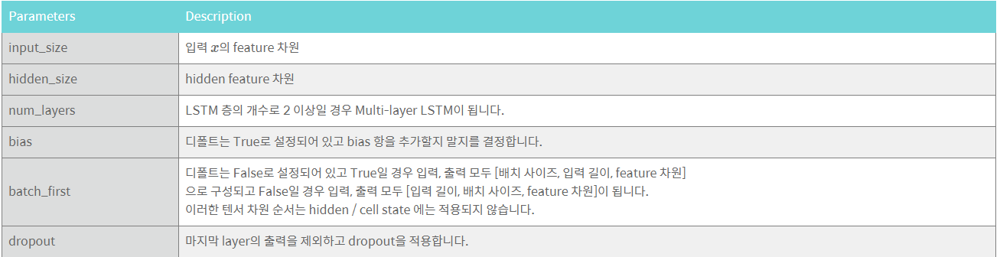

In [ ]:
class BasicLSTM(nn.Module):
    def __init__(self, n_layers, hidden_dim, n_vocab, embed_dim, n_classes):
        super(BasicLSTM, self).__init__()
        print("Building Basic LSTM model...")

        
        self.n_layers = n_layers 
        #n_vocab : Vocab 안에 있는 단어의 개수, embed_dim : 임베딩 된 단어 텐서가 갖는 차원 값(dimension)
        self.embed = nn.Embedding(n_vocab, embed_dim)
        self.hidden_dim = hidden_dim
#---------------------------------------------- 여기 밑부터 작성해주세요~-------------------------------------------------
        #앞에서 정의한 하이퍼 파라미터를 넣어 LSTM 정의
        self.lstm = nn.LSTM(input_size=embed_dim, 
                            hidden_size=self.hidden_dim, 
                            num_layers=self.n_layers,
                            batch_first=True)
        
        #Input: LSTM의 hidden state vector(context), Output : Class probability vector
        self.out = nn.Linear(self.hidden_dim, n_classes)
#----------------------------------------------여기까지-------------------------------------------------

    def forward(self, x):
        # Input data: 한 batch 내 모든 영화 평가 데이터
        
        x = self.embed(x)# 영화 평 임베딩

        # 초기 hidden, cell state vector를 zero vector로 생성
        h_0 = Variable(torch.zeros(self.n_layers, x.size(0), self.hidden_dim)).to(DEVICE)
        c_0 = Variable(torch.zeros(self.n_layers, x.size(0), self.hidden_dim)).to(DEVICE)
#------------------------------------------------여기 밑부터 작성해주세요-------------------------------------------------------------
        output, (h_t, c_t) = self.lstm(x, (h_0, c_0)) 
        #print(h_t.shape)
        #(1,64,h) ==> 64 batch-size,  h hidden_dimmension

        # 영화 리뷰 배열들을 압축한 hidden state vector
        # (batch_size, hidden_dim)형태의 텐서 추출
        h_t = h_t.view(-1, self.hidden_dim)

#-------------------------------------------------여기까지---------------------------------------------------------
        # linear layer의 입력으로 주고, 각 클래스 별 결과 logit을 생성.
        logit = self.out(h_t)  # [b, h] -> [b, o]
        return logit


In [ ]:
def train(model, optimizer, train_iter):
    model.train()
    for b, batch in enumerate(train_iter):
        x, y = batch.text.to(DEVICE), batch.label.to(DEVICE)
        optimizer.zero_grad()# 매번 기울기를 새로 계산하기 위해서 zero 로 초기화
        logit = model(x)#모델의 예측값 logit 계산
        #print(y)
        loss = F.cross_entropy(logit, y)# logit과 실제 label간의 오차를 구하고 기울기 계산
        loss.backward()
        optimizer.step()

In [ ]:
def evaluate(model, val_iter):
    """evaluate model"""                   
    model.eval()
    corrects, total_loss = 0, 0
    for batch in val_iter:# Validation 데이터셋에 대하여 
        x, y = batch.text.to(DEVICE), batch.label.to(DEVICE)
        logit = model(x)
        loss = F.cross_entropy(logit, y, reduction='sum')
        total_loss += loss.item()
        corrects += (logit.max(1)[1].view(y.size()).data == y.data).sum()
    #전체 validation 셋에 대한 평균 loss와 accuracy를 구하는 과정
    size = len(val_iter.dataset)
    avg_loss = total_loss / size
    avg_accuracy = 100.0 * corrects / size
    return avg_loss, avg_accuracy

In [ ]:
import os

vocab_size = 5000
n_classes = 2
lr = 0.001
EPOCHS= 9

참고 : __init__(self, n_layers, hidden_dim, n_vocab, embed_dim, n_classes):

In [ ]:
model = BasicLSTM(1, 32, vocab_size, 128, n_classes).to(DEVICE)
optimizer = torch.optim.Adam(model.parameters(), lr=lr)

Building Basic LSTM model...


In [ ]:
model

BasicLSTM(
  (embed): Embedding(5000, 128)
  (lstm): LSTM(128, 32, batch_first=True)
  (out): Linear(in_features=32, out_features=2, bias=True)
)

In [ ]:
train_iter = TD

In [ ]:
best_val_loss = None
for e in range(1, EPOCHS+1):
    train(model, optimizer, train_iter)
    val_loss, val_accuracy = evaluate(model, val_iter)

    print("[에폭: %d] 검증 오차:%5.2f | 검증 정확도:%5.2f" % (e, val_loss, val_accuracy))
    
    # 검증 오차가 가장 적은 최적의 모델을 저장
    if not best_val_loss or val_loss < best_val_loss:
        if not os.path.isdir("snapshot"):
            os.makedirs("snapshot")
        torch.save(model.state_dict(), './snapshot/txtclassification.pt')
        best_val_loss = val_loss

AttributeError: ignored

In [ ]:
model.load_state_dict(torch.load('./snapshot/txtclassification.pt'))
test_loss, test_acc = evaluate(model, test_iter)
print('테스트 오차: %5.2f | 테스트 정확도: %5.2f' % (test_loss, test_acc))